# 1 : Importer les nécessaires libraries

In [2]:
import pandas as pd
import numpy as np

# For plotting
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

# For standardising the data
from sklearn.preprocessing import StandardScaler

#t-SNE
from sklearn.manifold import TSNE

#KMeans
from sklearn.datasets import make_blobs

from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

# 2 : Importer le dataset

In [3]:
data=pd.read_csv("olist-customers-segmentation.csv", sep=',')

# 3 : Declarer les features

In [4]:
data.head()

,customer_unique_id,review_mean,conso_total,order_times,days_no_purchase
0,7c396fd4830fd04220f754e42b4e5bff,4.25,82.82,2,380.27
1,af07308b275d755c9edb36a90c618231,4.00,141.46,1,84.87
2,3a653a41f6f9fc3d2a113cf8398680e8,5.00,179.12,1,70.37
3,7c142cf63193a1473d2e66489a9ae977,5.00,72.20,1,332.92
4,72632f0f9dd73dfee390c9b22eb56dd6,5.00,28.62,1,245.84


In [5]:
X = data.iloc[:,1:5].values
X.shape

(95379, 4)

# 4 : Scaler les features

In [6]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 5 : Utiliser la méthode elbow methode  pour trouver l'optimal numbre de clusters

In [7]:
plt.rcParams["figure.figsize"] = (9,6)

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif


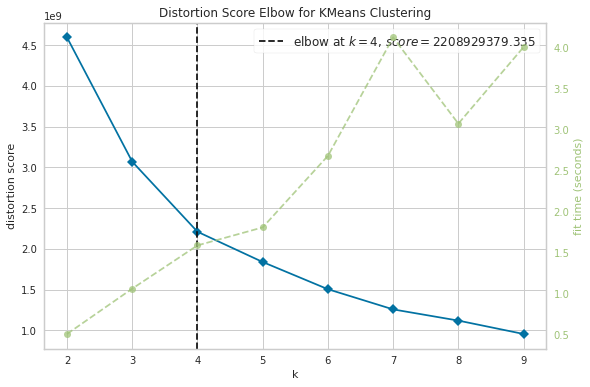

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [8]:
from sklearn.cluster import KMeans

from yellowbrick.cluster import KElbowVisualizer


# Instantiate the clustering model and visualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,10))

visualizer.fit(X)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data

Observation : Grâce à la méthode du coude basée sur le score de distortion (somme moyenne des carrés des distances aux centres), une segementation en K=4 clusters serait la meilleure option.

## 6: Afficher le coefficient de silhouette
Pour vérifier si ce clustering fonctionne, nous allons utiliser SilhouetteVisualizer pour afficher le coefficient de silhouette pour un échantillonage de chaque cluster. Cela permet de visualiser la densité et la séparation des clusters

In [9]:
plt.rcParams["figure.figsize"] = (12, 8)

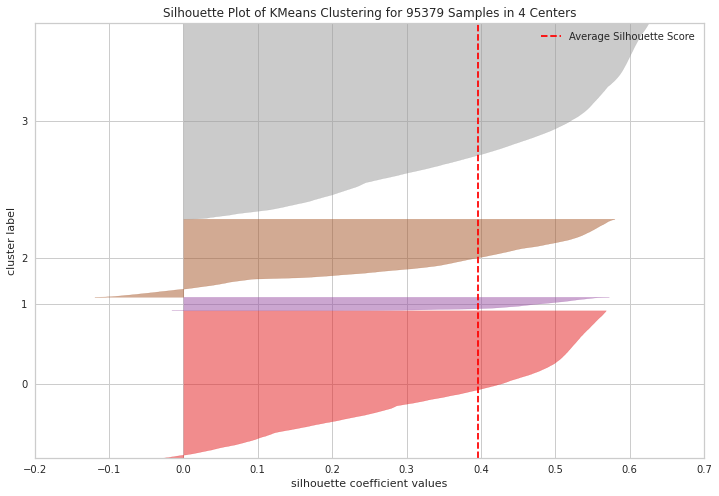

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 95379 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [10]:
from yellowbrick.cluster import SilhouetteVisualizer
# Best K in Elbow
K = visualizer.elbow_value_

# Instantiate the clustering model and visualizer 
kmeans_clusters = KMeans(K)

# Silhouette Visualizer
silhouette_visualizer = SilhouetteVisualizer(kmeans_clusters)
silhouette_visualizer.fit(X_scaled)
silhouette_visualizer.show()

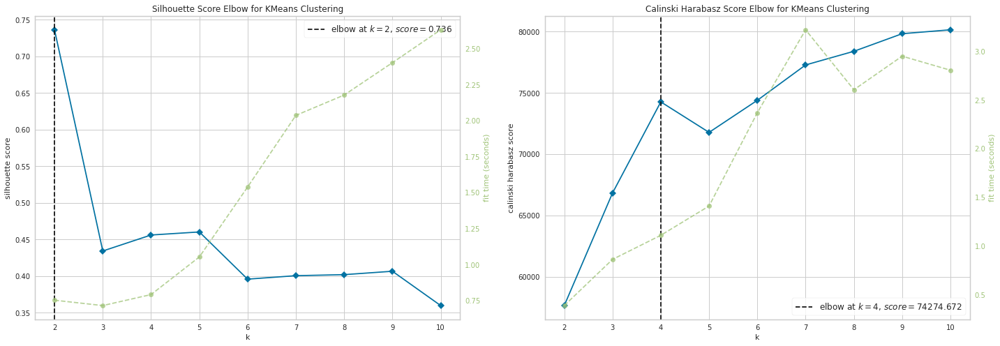

In [11]:
# Elbow method with differents metrics
metrics = ["silhouette", "calinski_harabasz"]
i = 0

fig, axes = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False, figsize=(24,8))
for m in metrics:
    visualizer = KElbowVisualizer(KMeans(),
                                K=(2,10),
                                metric=m,
                                ax=axes[i])
    visualizer.fit(X)
    visualizer.finalize()
    i+=1

plt.show()

On remarque ici que pour la métrique silhouette score, le nombre de K est également de 2. Pour le score Calinski Harabasz, le meilleur K est égale à 4.

# 7: Analyse des différents clusters

 Les scores sur la répartition en 4 clusters semblent être meilleurs. Nous allons donc conserver ce clustering en 4 groupes

In [12]:
# KMeans with best K
K = 4
kmeans_clusters= KMeans(K)
kmeans_clusters.fit(X_scaled)

# Kmeans labels
data["kmeans_label"] =  kmeans_clusters.labels_

In [13]:
data.to_csv("olist-customers-segmentation-label.csv",index=False)

In [14]:
data["kmeans_label"].value_counts() 

2    42926
1    32362
0    17126
3     2965
Name: kmeans_label, dtype: int64

Nous allons dans un premier temps grouper les individus par cluster pour analyser les moyennes :

In [15]:
kmeans_clusters_means = data.groupby("kmeans_label").mean().reset_index()
kmeans_clusters_means

,kmeans_label,review_mean,conso_total,order_times,days_no_purchase
0,0,1.585572,186.943969,1.000000,292.335606
1,1,4.631790,157.214244,1.000000,442.401654
2,2,4.667812,153.098645,1.000000,171.255578
3,3,4.116839,361.002422,2.110624,311.473609


# 8: Visualisation des données : Globale : `ACP` et Locale : `t-NSE` 

In [16]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2,perplexity=100, random_state=42)
X_tsne = tsne.fit_transform(X_scaled)

/home/ying/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/ying/.local/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


In [17]:
from sklearn import decomposition
pca = decomposition.PCA(n_components=2)
X_PCA=pca.fit_transform(X_scaled)

In [18]:
pca.explained_variance_ratio_

array([0.28766057, 0.25431761])

In [19]:
y = data["kmeans_label"]

In [20]:
import plotly.express as px
fig = px.scatter(x=X_PCA[:,0], y=X_PCA[:, 1], 
                 color=y, hover_name=y, height= 800, title="PCA"
                )
fig.show()

fig = px.scatter(x=X_tsne[:, 0], y=X_tsne[:, 1], 
                 color=y, hover_name=y, height=800, title="t-SNE"
                )
fig.show()

(-0.7, 0.7)

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif


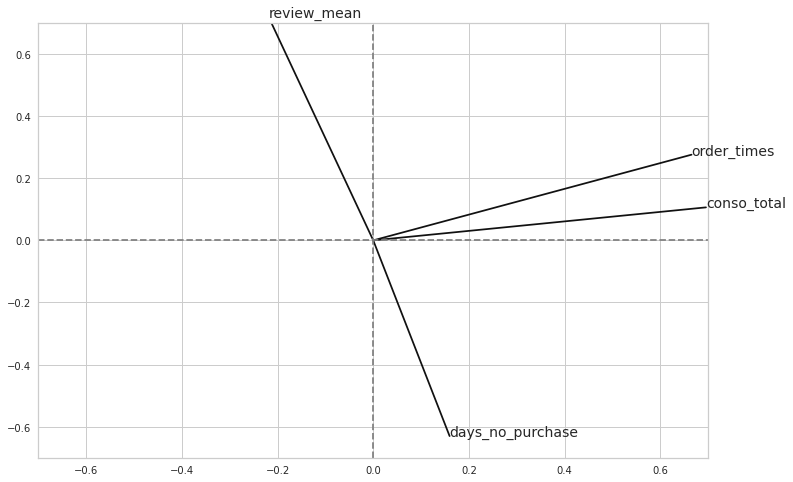

In [21]:
pcs = pca.components_

for i, (x, y) in enumerate(zip(pcs[0, :], pcs[1, :])):
    # Afficher un segment de l'origine au point (x, y)
    plt.plot([0, x], [0, y], color='k')
    # Afficher le nom (data.columns[i+1]) de la performance
    plt.text(x, y, data.columns[i+1], fontsize='14')

# Afficher une ligne horizontale y=0
plt.plot([-0.7, 0.7], [0, 0], color='grey', ls='--')

# Afficher une ligne verticale x=0
plt.plot([0, 0], [-0.7, 0.7], color='grey', ls='--')

plt.xlim([-0.7, 0.7])
plt.ylim([-0.7, 0.7])

## Distances intercluster

/home/ying/.local/lib/python3.8/site-packages/sklearn/manifold/_mds.py:517: UserWarning:

The MDS API has changed. ``fit`` now constructs an dissimilarity matrix from data. To use a custom dissimilarity matrix, set ``dissimilarity='precomputed'``.

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif


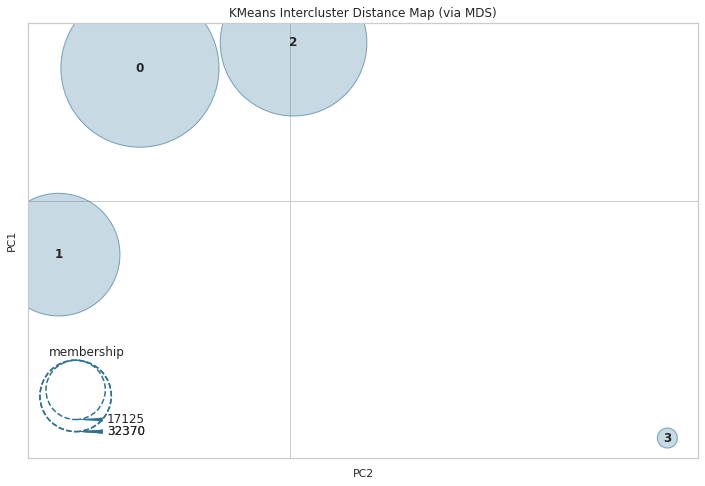

<AxesSubplot:title={'center':'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>

In [22]:
from yellowbrick.cluster import InterclusterDistance
# Intercluster distance Map with best k
distance_visualizer = InterclusterDistance(KMeans(K))
distance_visualizer.fit(X_scaled)
distance_visualizer.show()

Sur cette projection en 2D, on remarque que les différents clusters sont bien séparés sur les 2 premières composantes principales. Le clustering semble donc performant et il faut a présent identifier les composantes métier de chaque cluster.

# 10 : DBSCAN et Dendrogramme

In [1]:
from sklearn.model_selection import train_test_split
X_random, X_test,= train_test_split(X_scaled,test_size=0.8, random_state=42)

NameError: name 'X_scaled' is not defined

In [24]:
import sklearn.cluster
dbscan = sklearn.cluster.DBSCAN(eps = 0.5, min_samples = 50, metric = 'euclidean')
dbscan.fit(X_scaled)

DBSCAN(min_samples=50)

In [25]:
dbscan.labels_
np.unique(dbscan.labels_)

array([-1,  0,  1,  2,  3,  4])

In [26]:
import sklearn.cluster
hclust = sklearn.cluster.AgglomerativeClustering(n_clusters = 4, affinity = 'euclidean', linkage = 'ward')
hclust.fit(X_random)

: 

: 

In [ ]:
hclust.labels_
np.unique(hclust.labels_)

array([0, 1, 2, 3])